In [716]:
import socnet as sn
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import itertools
from operator import itemgetter
import matplotlib.pyplot as plt
import numpy as np


sn.graph_width = 800
sn.graph_height = 450

sn.node_size = 20
sn.node_color = (255, 255, 255)

sn.edge_width = 2
sn.edge_color = (0, 0, 0)

sn.node_label_position = 'middle center'
sn.edge_label_distance = 10

lista_paises_chegaram = []
lista_paises_sairam = []

posicao_paises_sairam = {}
posicao_paises_chegaram = {}

In [717]:
g = sn.load_graph('total_homicides.gml')

sn.show_graph(g, nlab=True)

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [718]:
h = nx.edge_betweenness_centrality(g, normalized=True, weight='weight')
sorted(h.items(), key=lambda kv: kv[1], reverse=True)

[((7, 10), 148.39363896097393),
 ((7, 72), 95.74018227629601),
 ((72, 10), 71.60248346165953),
 ((4, 144), 67.98222135248847),
 ((11, 7), 57.32454516973133),
 ((99, 10), 54.876524226756274),
 ((10, 7), 47.34803747035385),
 ((7, 71), 47.34740682000015),
 ((11, 68), 46.99877380336653),
 ((106, 10), 46.10946624347813),
 ((173, 7), 46.09032169152019),
 ((95, 10), 44.5608524369721),
 ((7, 39), 43.824293688082605),
 ((60, 10), 43.09028686024846),
 ((116, 7), 41.03036463356256),
 ((165, 11), 40.61692960410449),
 ((10, 76), 40.54814056608075),
 ((10, 68), 38.58714759181094),
 ((99, 7), 38.25218111041621),
 ((2, 7), 37.710893783356696),
 ((6, 7), 36.08636192968942),
 ((144, 56), 35.82219085476146),
 ((95, 7), 34.729375088683305),
 ((112, 7), 33.59330216922623),
 ((46, 56), 32.485241914673),
 ((68, 53), 31.89881682869892),
 ((106, 18), 30.890497081067167),
 ((11, 39), 30.663932684861805),
 ((72, 68), 30.098018641452715),
 ((142, 138), 29.797608446007562),
 ((104, 7), 29.757125043460356),
 ((72, 

In [719]:
soma = sum(h.values())
bet_corte = soma/len(h)*50

In [720]:
lista_baixa_crim = []
lista_alta_crim = []
lista_rep = []


for i in h:
    if float(h[i]) > bet_corte:
        if i[0] not in lista_alta_crim:
            lista_alta_crim.append(i[0])
        if i[1] not in lista_baixa_crim:
            lista_baixa_crim.append(i[1])
        
for pais in lista_rep:
    print (g.nodes[pais]['label'])

In [721]:
soma = 0.0
for i in lista_alta_crim:
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_alta_crim)

soma

105.65528546898449

In [722]:
soma = 0.0
for i in lista_baixa_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_baixa_crim)
soma

163.5039651006855

In [723]:
lista_rep = []

for i in lista_alta_crim:
    
    if i in lista_baixa_crim:
        lista_rep.append(i)
        lista_baixa_crim.remove(i)
        lista_alta_crim.remove(i)

In [724]:
# for i in lista_baixa_crim:
#     print(g.nodes[i]['label'])

In [725]:
soma = 0.0
for i in lista_alta_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_alta_crim)
soma

114.8950299093216

In [726]:
soma = 0.0
for i in lista_baixa_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_baixa_crim)
soma

197.41645367511958

In [727]:
lista_dif_homicides = []
lista_bet_edge = []

for i in h:
    
    lista_dif_homicides.append(float(g.nodes[i[1]]['homicides']) - float(g.nodes[i[0]]['homicides'])) 
    lista_bet_edge.append(h[i])

lista_dif_homicides
    

[7.579596680013793,
 0.0,
 -6.5750661786383695,
 -4.58308582306071,
 161.21993000217424,
 -8.77939341679306,
 -9.280775529127208,
 -1.8037282826179002,
 -6.799487111310533,
 -6.333966107843956,
 -13.923860065459344,
 -8.104989252084021,
 -12.426956636230699,
 34.84598472007039,
 -6.659663922161485,
 -11.552871150399817,
 19.511413219403963,
 22.939311985597783,
 18.308254652052753,
 2.6465460354788277,
 -9.21573007293371,
 146.1198331964378,
 -5.864356090327277,
 886.081318243193,
 -8.360011277124944,
 151.5383579324092,
 394.98436518850775,
 21.503456745473137,
 13.923860065459344,
 2.3709889150595274,
 17.661935392477055,
 0.0,
 5.818870813375323,
 7.348793886820975,
 5.144466648666285,
 12.120131782841444,
 218.81622975366662,
 7.264196143297859,
 297.57042515843017,
 1.4969034292286452,
 16.570406100938172,
 4.708129992525635,
 5.5638487883344006,
 29.572862538094547,
 241.11957929967556,
 4.933050644534966,
 -11.037261529102711,
 -2.6465460354788277,
 -9.306209957640313,
 -10.7515

In [728]:
print(stats.ttest_ind(lista_dif_homicides, lista_bet_edge))

Ttest_indResult(statistic=0.34495057978539395, pvalue=0.7301358233094726)


In [729]:
k = 1

comp = nx.algorithms.community.centrality.girvan_newman(g)
limited = itertools.takewhile(lambda c: len(c) <= k, comp)


for communities in limited:

    print(tuple(sorted(c) for c in communities)) 

LinregressResult(slope=-6.451094146003449e-06, intercept=0.006276857017735017, rvalue=-0.04936945463815143, pvalue=0.5116367781870648, stderr=9.809762852856761e-06)
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Grenada
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Puerto Rico
Barbados
Guyana
Jamaica
Bahamas
Trinidad and Tobago
Albania
El Salvador
Nicaragua
Paraguay
Namibia
Panama
Guatemala
Belize


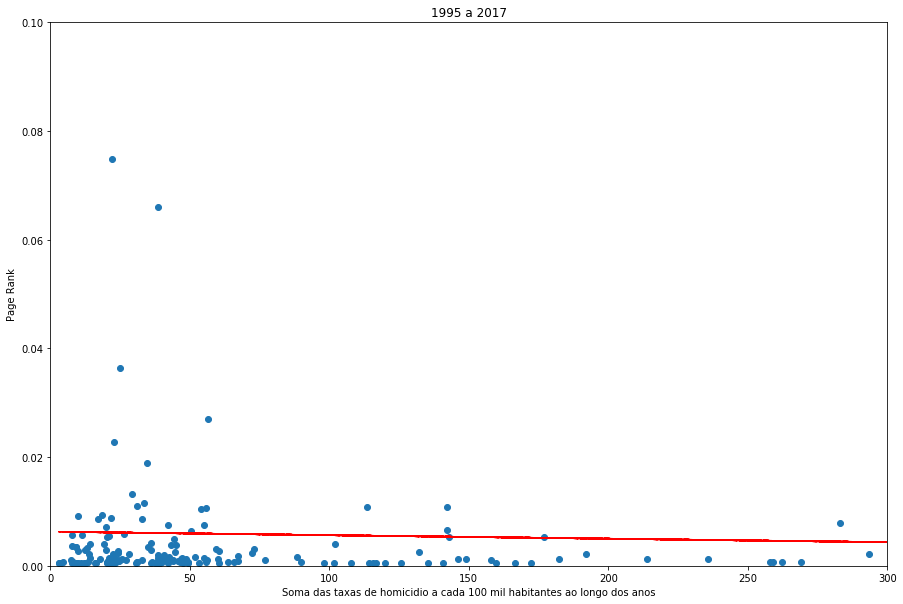

In [730]:
lista_homicidios = []
lista_pr = []
lista_in_degree = []

pr = nx.pagerank(g, alpha=0.9, weight='weight')

dic_pr = {}

for i in pr:
    
    dic_pr[g.nodes[i]['label']] = pr[i]
    
sorted_by_value = sorted(dic_pr.items(), key=lambda kv: kv[1])

sorted_by_value 

for i in sorted_by_value:
    lista_pr.append(float(i[1]))
    for n in g.nodes:
        if g.nodes[n]['label'] == i[0]:
            lista_homicidios.append(float(g.nodes[n]['homicides']))
            lista_in_degree.append(g.in_degree(n))

print(stats.linregress(lista_homicidios, lista_pr))


for i in range (0,len(lista_homicidios)-1):
    for j in range(len(sorted_by_value)):
        if lista_pr[i] < 0.001 and lista_homicidios[i] > 150 :
            if sorted_by_value[j][1] == lista_pr[i]:
                print(sorted_by_value[i][0])

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_pr)
z = np.polyfit(lista_homicidios, lista_pr ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
plt.ylim(0, 0.1)
plt.xlim(0, 300)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Page Rank')
plt.title('1995 a 2017')

plt.show()

LinregressResult(slope=-0.006951562680577924, intercept=47.88906619544933, rvalue=-0.03286092733761822, pvalue=0.6623382648548883, stderr=0.015892103458835898)
Tonga
Mauritius
Palau
British Virgin Islands
Vanuatu
Comoros
Fiji
Singapore
Turks and Caicos Islands
Oman
Haiti
Madagascar
Bahrain
China
United Arab Emirates
Malta
Cuba
Eritrea
Romania
Bulgaria
Cambodia
Djibouti
Peru
Israel
Uzbekistan
Rep. of Korea
Tunisia
Burkina Faso
Egypt
Timor-Leste
Turkey
Hungary
Jordan
Poland
Portugal
New Zealand
Tajikistan
Aruba
Morocco
Myanmar
Benin
Zimbabwe
Liberia
Indonesia
Chile
Afghanistan
Solomon Islands
Sierra Leone
Togo
Spain
Mali
Gambia
Papua New Guinea
Mauritania
Argentina
Gabon
Guinea
Algeria
Mozambique
Montenegro
Ghana
Bangladesh
India
Malawi
Sri Lanka
Chad
Croatia
Rwanda
South Sudan
Bosnia and Herzegovina
Turkmenistan
Ireland
Guinea-Bissau
Slovenia
Japan
Armenia
Ethiopia
Iceland
Somalia
Iraq
Zambia
Libya
Angola
Senegal
Niger
Qatar
Nigeria
Burundi
Liechtenstein
Switzerland
Lebanon
Cameroon
Lux

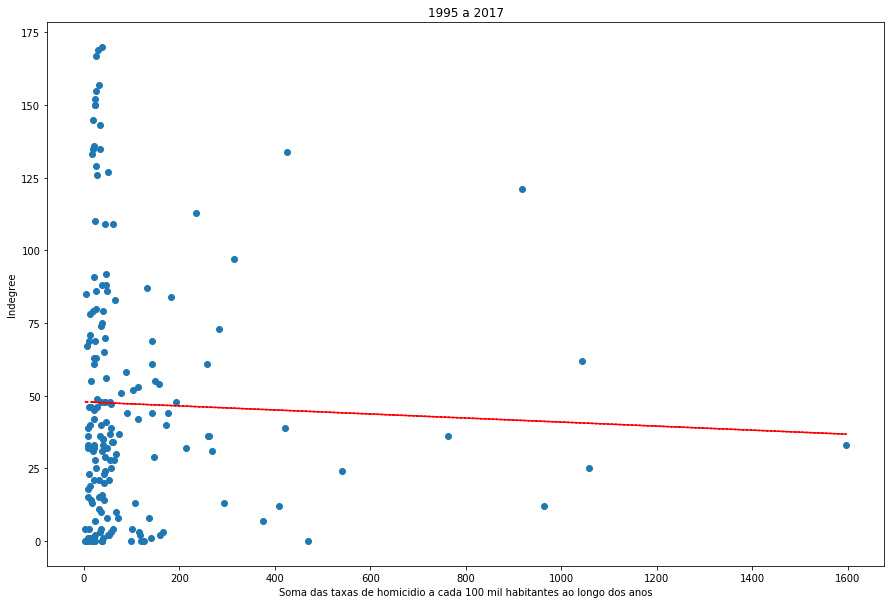

In [731]:
print(stats.linregress(lista_homicidios, lista_in_degree))
                

for i in range (0,len(lista_in_degree)-1):
    for j in range(len(sorted_by_value)):
        if lista_in_degree[i] > 1 and lista_homicidios[i] < 100 :
            if sorted_by_value[j][1] == lista_pr[i]:
                print(sorted_by_value[i][0])
    
plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_in_degree)
z = np.polyfit(lista_homicidios, lista_in_degree ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
#plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Indegree')
plt.title('1995 a 2017')

plt.show()

In [732]:
g = sn.load_graph('homicides95to99.gml')

sn.show_graph(g, nlab=True)

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [733]:
h = nx.edge_betweenness_centrality(g, normalized=True, weight='weight')
sorted(h.items(), key=lambda kv: kv[1], reverse=True)


soma = sum(h.values())
bet_corte = soma/len(h)*4

In [734]:
lista_baixa_crim = []
lista_alta_crim = []
lista_rep = []

for i in h:
    if float(h[i]) > bet_corte:
        if i[0] not in lista_alta_crim:
            lista_alta_crim.append(i[0])
        if i[1] not in lista_baixa_crim:
            lista_baixa_crim.append(i[1])
        
for pais in lista_rep:
    #print(pais)
    print (g.nodes[pais]['label'])

In [735]:
soma = 0.0
for i in lista_alta_crim:
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_alta_crim)

soma

52.59475242466316

In [736]:
soma = 0.0
for i in lista_baixa_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_baixa_crim)
soma

59.95037353754

In [737]:
lista_dif_homicides = []
lista_bet_edge = []

for i in h:
    
    lista_dif_homicides.append(float(g.nodes[i[1]]['homicides']) - float(g.nodes[i[0]]['homicides'])) 
    lista_bet_edge.append(h[i])

lista_dif_homicides
    

[0.23191615999999904,
 0.0,
 -1.1820190870000005,
 -0.6708427630000013,
 44.964079547,
 -3.333277109600001,
 -1.4188308860000012,
 -2.113913968000001,
 -4.129668958000001,
 -3.7448734868000004,
 -1.5267198090000011,
 -4.053756268000001,
 16.233755565999996,
 -3.147729141000001,
 -2.6802754140000005,
 4.945693111000001,
 -0.593309887000002,
 6.107081069999998,
 -2.5377494469000013,
 61.74068144600001,
 -0.6255638500000007,
 282.80704324600003,
 -2.820368429000001,
 20.189872793000003,
 3.9767896467999995,
 3.7448734868000004,
 1.0645980728,
 4.4224463238,
 0.0,
 2.2181536777999993,
 2.5628543998,
 0.41159637719999953,
 2.3260426007999992,
 0.5971443457999994,
 68.2629870828,
 -0.30888278120000034,
 1.2071240398999992,
 0.9245050577999994,
 7.056514963799999,
 49.3534693308,
 -3.5651932696,
 -0.23191615999999904,
 -1.4139352469999995,
 -1.7586359690000002,
 4.788943216000002,
 -3.379645301,
 -3.9767896467999995,
 0.0,
 -2.9121915739999995,
 4.713776951000002,
 -1.6507470460000002,
 -4.28

In [738]:
print(stats.linregress(lista_dif_homicides, lista_bet_edge))

LinregressResult(slope=0.0009923114901114608, intercept=0.42368088237672386, rvalue=0.045687364356034994, pvalue=0.039224402941179806, stderr=0.00048096777076939655)


In [739]:
k = 5

comp = nx.algorithms.community.centrality.girvan_newman(g)
limited = itertools.takewhile(lambda c: len(c) <= k, comp)


for communities in limited:

    print(tuple(sorted(c) for c in communities)) 

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74], [70])
([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 71, 72, 73], [70], [74])
([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 72, 73], [70], [71], [74])
([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 2

In [740]:
# l = [0, 2, 4, 5, 6, 8, 10, 13, 14, 15, 17, 18, 22, 25, 27, 31, 32, 33, 51, 52, 53, 60, 61, 64, 65, 66]

# for i in l:
#     print(g.nodes[i]['label'])

LinregressResult(slope=-4.5326559172860466e-05, intercept=0.015254960339076562, rvalue=-0.08077554827793058, pvalue=0.49087715893098005, stderr=6.546210207262413e-05)


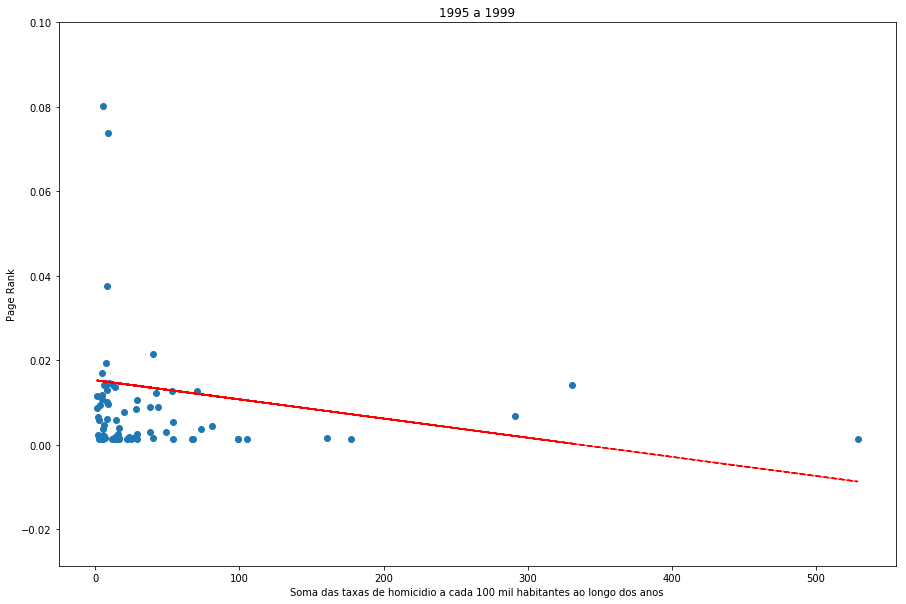

In [741]:
lista_homicidios = []
lista_pr = []
lista_in_degree = []

pr = nx.pagerank(g, alpha=0.9, weight='weight')

dic_pr = {}

for i in pr:
    
    dic_pr[g.nodes[i]['label']] = pr[i]
    
sorted_by_value = sorted(dic_pr.items(), key=lambda kv: kv[1])

sorted_by_value 

for i in sorted_by_value:
    lista_pr.append(float(i[1]))
    for n in g.nodes:
        if g.nodes[n]['label'] == i[0]:
            lista_homicidios.append(float(g.nodes[n]['homicides']))
            lista_in_degree.append(g.in_degree(n))

print(stats.linregress(lista_homicidios, lista_pr))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_pr)
z = np.polyfit(lista_homicidios, lista_pr ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Page Rank')
plt.title('1995 a 1999')

plt.show()

LinregressResult(slope=-0.04912427882084378, intercept=29.242631961093473, rvalue=-0.1780285903554106, pvalue=0.12648453043550653, stderr=0.03177980849815124)


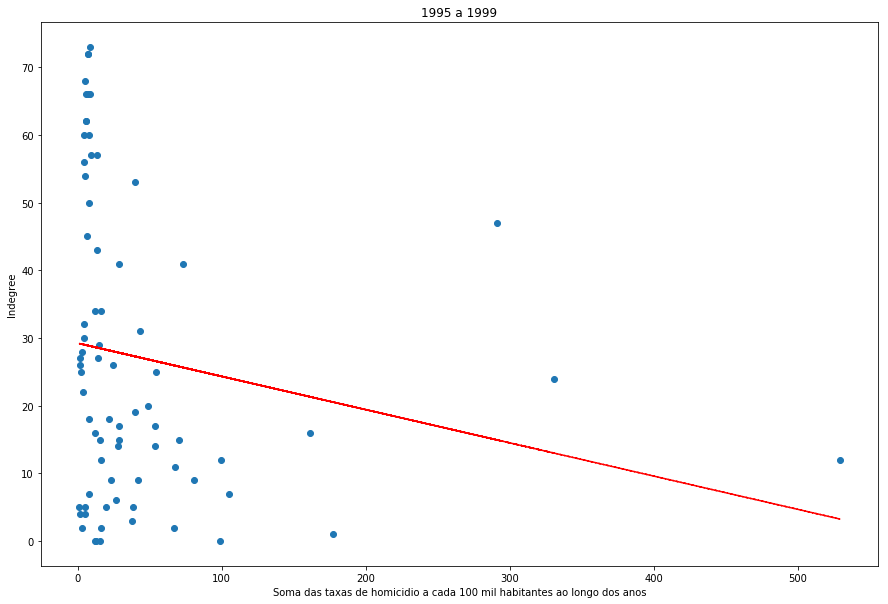

In [742]:
print(stats.linregress(lista_homicidios, lista_in_degree))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_in_degree)
z = np.polyfit(lista_homicidios, lista_in_degree ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
#plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Indegree')
plt.title('1995 a 1999')

plt.show()

In [743]:
g = sn.load_graph('homicides00to10.gml')

sn.show_graph(g, nlab=True)

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [744]:
h = nx.edge_betweenness_centrality(g, normalized=True, weight='weight')
sorted(h.items(), key=lambda kv: kv[1], reverse=True)


soma = sum(h.values())
bet_corte = soma/len(h)*4

In [745]:
lista_baixa_crim = []
lista_alta_crim = []
lista_rep = []

for i in h:
    if float(h[i]) > bet_corte:
        if i[0] not in lista_alta_crim:
            lista_alta_crim.append(i[0])
        if i[1] not in lista_baixa_crim:
            lista_baixa_crim.append(i[1])
        
for pais in lista_rep:
    #print(pais)
    print (g.nodes[pais]['label'])

In [746]:
soma = 0.0
for i in lista_alta_crim:
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_alta_crim)

soma

77.154726545066

In [747]:
soma = 0.0
for i in lista_baixa_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_baixa_crim)
soma

76.15151543920354

In [748]:
lista_rep = []

for i in lista_alta_crim:
    
    if i in lista_baixa_crim:
        lista_rep.append(i)
        lista_baixa_crim.remove(i)
        lista_alta_crim.remove(i)

In [749]:
lista_dif_homicides = []
lista_bet_edge = []

for i in h:
    
    lista_dif_homicides.append(float(g.nodes[i[1]]['homicides']) - float(g.nodes[i[0]]['homicides'])) 
    lista_bet_edge.append(h[i])

lista_dif_homicides
    

[3.9458827890000023,
 0.0,
 -4.652365464799997,
 -4.668478840099999,
 85.860906478,
 -4.8479356055,
 1.0117752170999985,
 -0.206215444999998,
 -2.2953989407999984,
 -2.0781251419999975,
 -8.228124675899998,
 -4.740037892199998,
 -7.407282829399998,
 15.098002589000004,
 -2.990802217599997,
 -6.239278090699999,
 10.930652317,
 18.620905191,
 8.991437690000001,
 7.973337075000003,
 -6.250771479500001,
 70.687659888,
 -3.955300206499997,
 417.06663326399996,
 -3.5684018733999974,
 76.24535568300001,
 246.46429508399993,
 12.1740074649,
 8.228124675899998,
 1.9888465852000001,
 9.520141875900002,
 0.0,
 3.488086783700001,
 3.575759211100002,
 3.3801890703999993,
 8.0219092309,
 168.31967732990003,
 5.237322458300002,
 118.52342929390001,
 0.8208418465000014,
 16.201461750900002,
 1.9773531963999984,
 4.659722802500002,
 20.1742858379,
 111.56640914890002,
 -4.027454286000001,
 -13.512412018000001,
 -7.973337075000003,
 -10.9641392926,
 -12.713374967200002,
 -14.212615165700003,
 -15.380619

In [750]:
print(stats.linregress(lista_dif_homicides, lista_bet_edge))

LinregressResult(slope=5.069321229558382e-05, intercept=0.42060240657491277, rvalue=0.0023587257650341544, pvalue=0.8356970412127568, stderr=0.00024441352264229215)


In [751]:
k = 3

comp = nx.algorithms.community.centrality.girvan_newman(g)
limited = itertools.takewhile(lambda c: len(c) <= k, comp)


for communities in limited:

    print(tuple(sorted(c) for c in communities)) 

LinregressResult(slope=-1.5694008737464168e-05, intercept=0.0068047160795066735, rvalue=-0.05980768349007808, pvalue=0.43577423197940734, stderr=2.0089740581635442e-05)


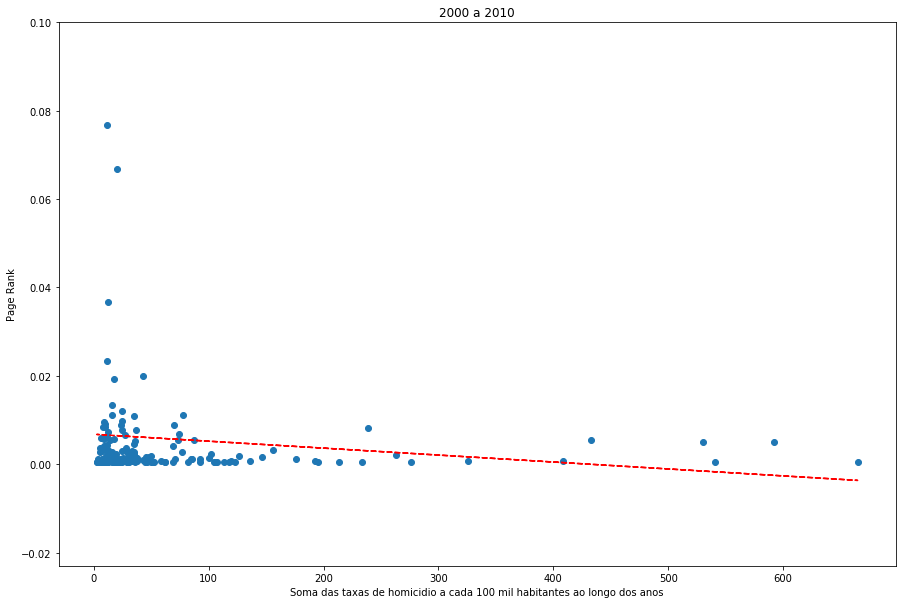

In [752]:
lista_homicidios = []
lista_pr = []
lista_in_degree = []

pr = nx.pagerank(g, alpha=0.9, weight='weight')

dic_pr = {}

for i in pr:
    
    dic_pr[g.nodes[i]['label']] = pr[i]
    
sorted_by_value = sorted(dic_pr.items(), key=lambda kv: kv[1])

sorted_by_value 

for i in sorted_by_value:
    lista_pr.append(float(i[1]))
    for n in g.nodes:
        if g.nodes[n]['label'] == i[0]:
            lista_homicidios.append(float(g.nodes[n]['homicides']))
            lista_in_degree.append(g.in_degree(n))

print(stats.linregress(lista_homicidios, lista_pr))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_pr)
z = np.polyfit(lista_homicidios, lista_pr ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Page Rank')
plt.title('2000 a 2010')

plt.show()

LinregressResult(slope=-0.022724509575315178, intercept=46.39971430725589, rvalue=-0.05720624443100644, pvalue=0.4560342812156295, stderr=0.030416891580124474)


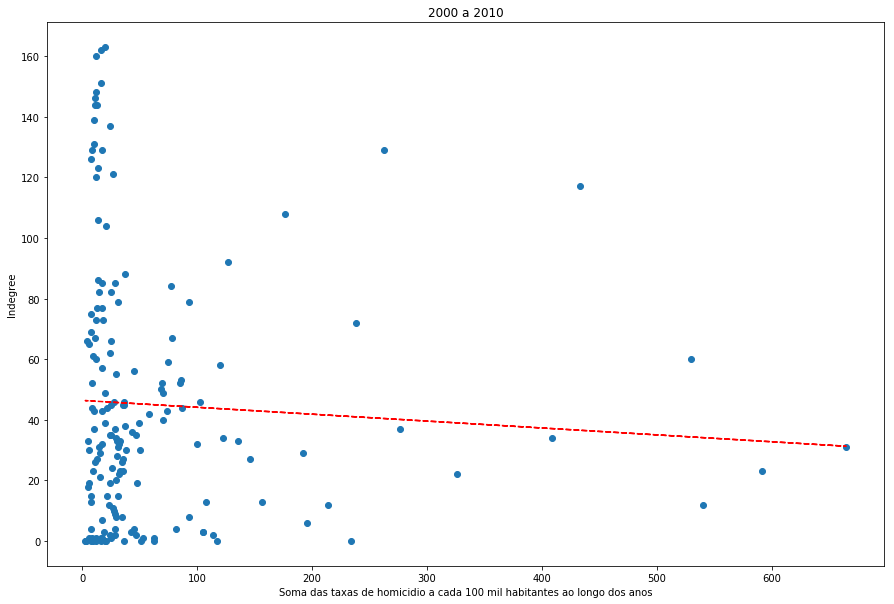

In [753]:
print(stats.linregress(lista_homicidios, lista_in_degree))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_in_degree)
z = np.polyfit(lista_homicidios, lista_in_degree ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
#plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Indegree')
plt.title('2000 a 2010')

plt.show()

In [754]:
g = sn.load_graph('homicides11to17.gml')

sn.show_graph(g, nlab=True)

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/PF-refaccao/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [755]:
h = nx.edge_betweenness_centrality(g, normalized=True, weight='weight')
sorted(h.items(), key=lambda kv: kv[1], reverse=True)


soma = sum(h.values())
bet_corte = soma/len(h)*4

In [756]:
lista_baixa_crim = []
lista_alta_crim = []
lista_rep = []

for i in h:
    if float(h[i]) > bet_corte:
        if i[0] not in lista_alta_crim:
            lista_alta_crim.append(i[0])
        if i[1] not in lista_baixa_crim:
            lista_baixa_crim.append(i[1])
        
for pais in lista_rep:
    #print(pais)
    print (g.nodes[pais]['label'])

In [757]:
soma = 0.0
for i in lista_alta_crim:
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_alta_crim)

soma

34.23064992478616

In [758]:
soma = 0.0
for i in lista_baixa_crim:
    
    soma += float(g.nodes[i]['homicides'])
    
soma = soma/len(lista_baixa_crim)
soma

37.74795001312049

In [759]:
lista_dif_homicides = []
lista_bet_edge = []

for i in h:
    
    lista_dif_homicides.append(float(g.nodes[i[1]]['homicides']) - float(g.nodes[i[0]]['homicides'])) 
    lista_bet_edge.append(h[i])

lista_dif_homicides
    

[3.4017977324999995,
 0.0,
 -0.7406816270999999,
 0.7562357814999991,
 30.3949439765,
 -0.5981807035000006,
 -1.7259522894000003,
 -0.1786819509000006,
 -2.3901742036,
 -0.12617200900000025,
 -1.9508619021000007,
 -1.8382315511999998,
 -0.9659175391000003,
 3.5142265634999985,
 -0.5211325637000002,
 -2.6333176461000005,
 3.6350677925,
 4.911716683499999,
 3.2097358914999985,
 3.2398074154999987,
 -0.42720914620000006,
 13.6914918565,
 -1.2834920322000007,
 186.20764176749998,
 -1.9712409744999997,
 55.10312946449999,
 157.08666856749997,
 5.3526596346,
 1.9508619021000007,
 -0.6824557439999999,
 3.7193471916000007,
 0.0,
 0.11263035090000084,
 1.2101802750000008,
 1.3526811986,
 1.7721799512,
 55.318277372599994,
 1.4297293384000005,
 110.78400879960002,
 0.9849443630000003,
 5.190669317599999,
 1.5236527559000006,
 -0.020379072399999032,
 2.3420617366,
 80.19970079560001,
 0.16199031700000077,
 2.4751504870000005,
 -3.2398074154999987,
 -3.760939979199999,
 -5.0780389666999985,
 -5.87

In [760]:
print(stats.linregress(lista_dif_homicides, lista_bet_edge))

LinregressResult(slope=-0.00037934110726361737, intercept=0.5080252673649633, rvalue=-0.007886191564391338, pvalue=0.48171838857568805, stderr=0.0005391626852071095)


In [761]:
k = 5

comp = nx.algorithms.community.centrality.girvan_newman(g)
limited = itertools.takewhile(lambda c: len(c) <= k, comp)


for communities in limited:

    print(tuple(sorted(c) for c in communities)) 

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 165], [164])
([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70,

LinregressResult(slope=-2.4499451041758427e-05, intercept=0.0067789956848309935, rvalue=-0.05472717250693986, pvalue=0.4837354051664241, stderr=3.4904391626993065e-05)


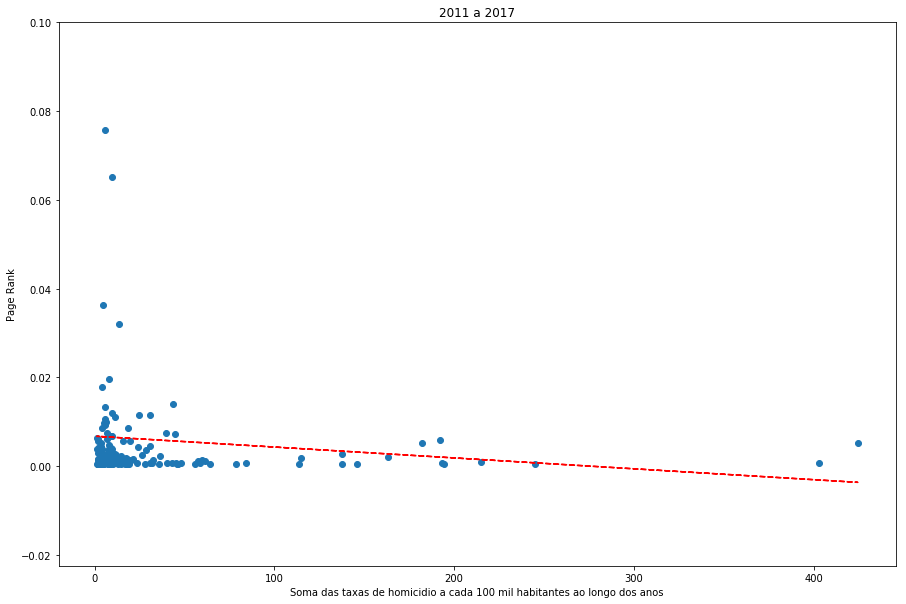

In [762]:
lista_homicidios = []
lista_pr = []
lista_in_degree = []

pr = nx.pagerank(g, alpha=0.9, weight='weight')

dic_pr = {}

for i in pr:
    
    dic_pr[g.nodes[i]['label']] = pr[i]
    
sorted_by_value = sorted(dic_pr.items(), key=lambda kv: kv[1])

sorted_by_value 

for i in sorted_by_value:
    lista_pr.append(float(i[1]))
    for n in g.nodes:
        if g.nodes[n]['label'] == i[0]:
            lista_homicidios.append(float(g.nodes[n]['homicides']))
            lista_in_degree.append(g.in_degree(n))

print(stats.linregress(lista_homicidios, lista_pr))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_pr)
z = np.polyfit(lista_homicidios, lista_pr ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Page Rank')
plt.title('2011 a 2017')

plt.show()

LinregressResult(slope=-0.05676937790224783, intercept=49.70706087033976, rvalue=-0.08298637598739649, pvalue=0.2878000622970539, stderr=0.05323347317868237)


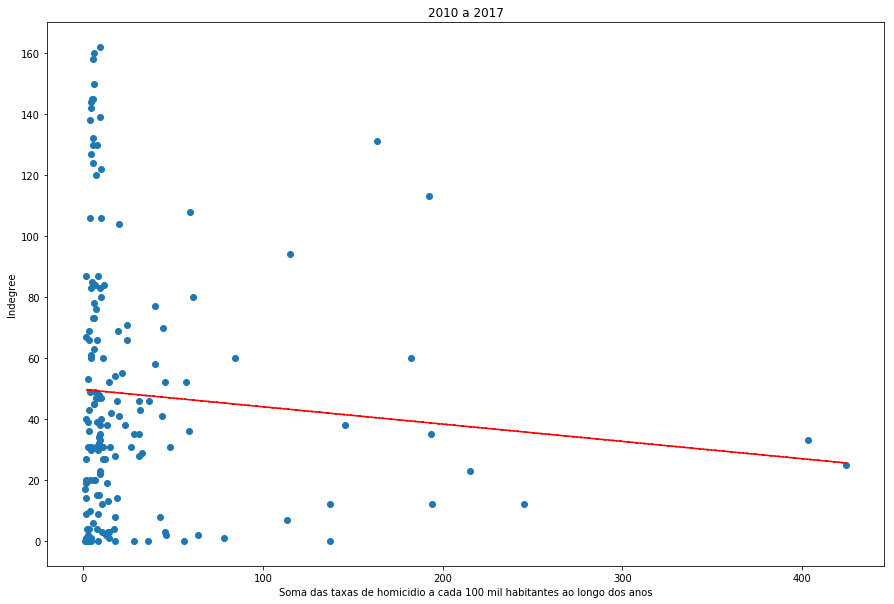

In [763]:
print(stats.linregress(lista_homicidios, lista_in_degree))

plt.figure(figsize=(15,10))
plt.scatter(lista_homicidios, lista_in_degree)
z = np.polyfit(lista_homicidios, lista_in_degree ,1)
p = np.poly1d(z)
plt.plot(lista_homicidios,p(lista_homicidios),"r--")
#plt.ylim(top=0.1)
plt.xlabel('Soma das taxas de homicidio a cada 100 mil habitantes ao longo dos anos')
plt.ylabel('Indegree')
plt.title('2010 a 2017')

plt.show()